In [344]:
from cartoframes.auth import set_default_credentials
from cartoframes.viz import Map, Layer, color_category_style, color_continuous_style, basic_style, size_continuous_style, basic_legend
import censusdata
import fiona

import requests
import json

import geopandas as gpd
import pandas as pd

from matplotlib import pyplot as plt
import numpy as np


In [2]:
# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 50)
# pd.options.display.max_colwidth = 2000

##### Things that I want to check when I load any shapefile

In [41]:
def to_epsg_4326(gdf):
    '''
    Checks CRS of geodataframe and convert it to epsg_4326 if not already that
    Note: gdf.crs['init'] will now error, just do gdf.crs- https://geopandas.org/projections.html
    '''
    current_crs = gdf.crs
    if current_crs == 'epsg:4326':
        print('CRS was already epsg:4326')
        return gdf
    else:
        print("Current CRS was {}. Reprojecting to epsg:4326.".format(current_crs))
        reprojected_gdf = gdf.to_crs(epsg=4326)
        return reprojected_gdf
        

#### Load credentials to create maps in Carto

In [50]:
set_default_credentials('credentials/carto_cred.json')


#### Load the shapefile containing NYC's preliminary flood hazard boundaries 
This is the Preliminary Flood Hazard Boundaries (S_Fld_Haz_Ar table table) documented on FEMA's website here: https://hazards.fema.gov/gis/nfhl/rest/services/PrelimPending/Prelim_NFHL/MapServer

These are the PFIRM flood zone designations proposed in 2015 by FEMA currently on hold because of the dispute by the NYC government. They would increase the number of people in a high-risk zone in NYC significantly. This is important because people in a high risk zone currently have flood insurance premiums as much as 6X as high as those in mid-risk areas, and are required by law to buy flood insurance if they have a federally-backed mortgage.

**Key columns in this data**:
- FLD_ZONE: This is the flood risk category that the area falls into according to FEMA.

In [42]:
#Load in geometry
PFIRM_gdf = gpd.read_file("raw_data/proposed_FIRM_NYC_2015/s_fld_haz_ar.shp")
PFIRM_gdf.to_crs(epsg=3857, inplace = True)

#Reproject
PFIRM_gdf = to_epsg_4326(PFIRM_gdf)

#Display
display(PFIRM_gdf.head())

#Stats
print("There are {} flooding zones defined.".format(PFIRM_gdf.shape[0]))
display("They are distributed across categories as such:")
display(PFIRM_gdf.groupby(['FLD_ZONE'])['FLD_AR_ID'].count())

Current CRS was epsg:3857. Reprojecting to epsg:4326.


,FLD_AR_ID,FLD_ZONE,FLOODWAY,SFHA_TF,STATIC_BFE,V_DATUM,DEPTH,LEN_UNIT,VELOCITY,VEL_UNIT,AR_REVERT,BFE_REVERT,DEP_REVERT,SOURCE_CIT,geometry
0,81,AE,None,T,13.0,NAVD88,-9999.0,FEET,-9999.0,None,None,-9999.0,-9999.0,STUDY4,"POLYGON ((-73.82729 40.89080, -73.82728 40.890..."
1,82,X,None,F,-9999.0,None,-9999.0,None,-9999.0,None,None,-9999.0,-9999.0,STUDY4,"POLYGON ((-73.82097 40.89055, -73.82096 40.890..."
2,83,0.2 PCT ANNUAL CHANCE FLOOD HAZARD,None,F,-9999.0,None,-9999.0,None,-9999.0,None,None,-9999.0,-9999.0,STUDY4,"POLYGON ((-73.82256 40.88991, -73.82252 40.889..."
3,84,0.2 PCT ANNUAL CHANCE FLOOD HAZARD,None,F,-9999.0,None,-9999.0,None,-9999.0,None,None,-9999.0,-9999.0,STUDY4,"POLYGON ((-73.82219 40.88747, -73.82219 40.887..."
4,85,0.2 PCT ANNUAL CHANCE FLOOD HAZARD,None,F,-9999.0,None,-9999.0,None,-9999.0,None,None,-9999.0,-9999.0,STUDY4,"POLYGON ((-73.81975 40.88694, -73.81975 40.886..."


There are 3985 flooding zones defined.


'They are distributed across categories as such:'

FLD_ZONE
0.2 PCT ANNUAL CHANCE FLOOD HAZARD    1726
A                                       21
AE                                    1269
AO                                      12
OPEN WATER                               8
VE                                     420
X                                      529
Name: FLD_AR_ID, dtype: int64

#### Explanation of these categories
Guides to the above FLD_ZONE categories used to understand the FLD_ZONE categories: 
- https://www.mapwise.com/data/metadata/fema-flood-zones
- https://www.fema.gov/glossary/flood-zones
- https://www.centralpointoregon.gov/sites/default/files/fileattachments/floodplain_management/page/416/quick_guide_to_understanding_flood_zones.pdf

1. High-risk zones are defined as areas that has a 1% chance of flooding in a year (26% chance of flooding at least once in a 30 year mortgage). This includes VE, AE, AO, A (https://www1.nyc.gov/site/floodmaps/insurance/overview.page). 
2. Moderate-risk is defined as everything that is between the limits of the 1% and .2% limits. Zone B (I think here labeled as 0.2 PCT ANNUAL CHANCE FLOOD HAZARD) are the areas that have a .2% change of flooding in a year (6% change of flooding at least once in a 30 year mortgage). Zone X (Shaded) are the areas between the 1% outer limit and .2% inner limit.
3. Minimal-risk are the areas outside the high-risk and moderate-risk zones. These are the areas labeled Zone C or Zone X (Unshaded).

*High risk areas are also known by FEMA as Special Flood Hazard Areas (SFHAs). Non-Special Flood Hazard Area (NSFHA) include both moderate and minimal-risk zones.*

#### Subsetting out zones of interest based on above:
Subsetting high risk zones and moderate risk zones

*Other inference to complete this subsetting:
The dataset does not specify whether the things labeled X are 'Unshaded' or 'Shaded'. By plotting X below and comparing it with NYC's official map of the disputed 2015 proposal (https://www.arcgis.com/apps/webappviewer/index.html?id=1c37d271fba14163bbb520517153d6d5) which labels the X (Shaded) areas, I can see that the areas ambiguously labeled X here are Unshaded, minimal risk areas. The things labeled '0.2 PCT ANNUAL CHANCE FLOOD HAZARD' are the areas that are labeled 
X (Shaded) on NYC's official map.*

In [43]:
high_risk_categories_PFIRM = ['A', 'AE', 'AO', 'VE']
high_risk_gdf_PFIRM = PFIRM_gdf[PFIRM_gdf['FLD_ZONE'].isin(high_risk_categories_PFIRM)]

moderate_risk_category_PFIRM = ['0.2 PCT ANNUAL CHANCE FLOOD HAZARD']
moderate_risk_gdf_PFIRM = PFIRM_gdf[PFIRM_gdf['FLD_ZONE'].isin(moderate_risk_category_PFIRM)]

In [79]:
#Take out encode_date=False to have legend in separate tab
# high_risk_layer = Layer(
#     high_risk_gdf_PFIRM, 
#     style=color_category_style('FLD_ZONE'), 
#     legends=basic_legend(title='High risk'),
#     encode_data =False)

# moderate_risk_layer = Layer(moderate_risk_gdf_PFIRM, 
#        style=color_category_style('FLD_ZONE', opacity=.9, palette ='Teal'), 
#        legends=basic_legend(title='Moderate risk'), 
#        encode_data=False)

# Map(layers = [moderate_risk_layer, high_risk_layer])

#### Load the shapefile containing NYC's effective flood hazard boundaries 
These are the flood hazard boundaries currently being used to make flood insurance decisions. They were digitized in 2007 and are based on data from 1983. When Hurricane Sandy hit in 2011 they were proven to be very inaccurate. Much more of NYC is currently in a high risk zone than these maps claim.

Data source: https://msc.fema.gov/portal/advanceSearch#searchresultsanchor
Search for New York City and download NFHL Data - County to download shapefile

Data columns changed between the 2007 and above 2015 version. FLD_ZONE still specifies the zone categorization VE, A, AE, etc., but in this version the ones labeled X contain both the minimal and moderate flood hazard areas. Use ZONE_SUBTY to differentiate.

In [118]:
EFIRM_gdf.columns

Index(['DFIRM_ID', 'VERSION_ID', 'FLD_AR_ID', 'STUDY_TYP', 'FLD_ZONE',
       'ZONE_SUBTY', 'SFHA_TF', 'STATIC_BFE', 'V_DATUM', 'DEPTH', 'LEN_UNIT',
       'VELOCITY', 'VEL_UNIT', 'AR_REVERT', 'AR_SUBTRV', 'BFE_REVERT',
       'DEP_REVERT', 'DUAL_ZONE', 'SOURCE_CIT', 'geometry'],
      dtype='object')

In [45]:
#Load in geometry
EFIRM_gdf = gpd.read_file("raw_data/effective_FIRM_NYC_2007/S_FLD_HAZ_AR.shp")
EFIRM_gdf.to_crs(epsg=3857, inplace = True)

#Reproject
EFIRM_gdf = to_epsg_4326(EFIRM_gdf)

#Display
display(EFIRM_gdf.head())

#Stats
print("There are {} flooding zones defined.".format(EFIRM_gdf.shape[0]))
display("They are distributed across categories as such:")
display(EFIRM_gdf.groupby(['FLD_ZONE'])['FLD_AR_ID'].count())

Current CRS was epsg:3857. Reprojecting to epsg:4326.


,DFIRM_ID,VERSION_ID,FLD_AR_ID,STUDY_TYP,FLD_ZONE,ZONE_SUBTY,SFHA_TF,STATIC_BFE,V_DATUM,DEPTH,LEN_UNIT,VELOCITY,VEL_UNIT,AR_REVERT,AR_SUBTRV,BFE_REVERT,DEP_REVERT,DUAL_ZONE,SOURCE_CIT,geometry
0,360497,1.1.1.0,360497_67,NP,X,AREA OF MINIMAL FLOOD HAZARD,F,-9999.0,None,-9999.0,None,-9999.0,None,None,None,-9999.0,-9999.0,None,360497_FIS1,"POLYGON ((-73.93225 40.58002, -73.93223 40.579..."
1,360497,1.1.1.0,360497_68,NP,X,0.2 PCT ANNUAL CHANCE FLOOD HAZARD,F,-9999.0,None,-9999.0,None,-9999.0,None,None,None,-9999.0,-9999.0,None,360497_FIS1,"POLYGON ((-73.89505 40.56180, -73.89510 40.561..."
2,360497,1.1.1.0,360497_69,NP,X,0.2 PCT ANNUAL CHANCE FLOOD HAZARD,F,-9999.0,None,-9999.0,None,-9999.0,None,None,None,-9999.0,-9999.0,None,360497_FIS1,"POLYGON ((-74.13140 40.58497, -74.13134 40.585..."
3,360497,1.1.1.0,360497_70,NP,X,AREA OF MINIMAL FLOOD HAZARD,F,-9999.0,None,-9999.0,None,-9999.0,None,None,None,-9999.0,-9999.0,None,360497_FIS1,"POLYGON ((-73.84069 40.65604, -73.84069 40.656..."
4,360497,1.1.1.0,360497_71,NP,X,AREA OF MINIMAL FLOOD HAZARD,F,-9999.0,None,-9999.0,None,-9999.0,None,None,None,-9999.0,-9999.0,None,360497_FIS1,"POLYGON ((-73.83994 40.64953, -73.83993 40.649..."


There are 2018 flooding zones defined.


'They are distributed across categories as such:'

FLD_ZONE
A               17
AE             469
OPEN WATER       4
VE              77
X             1451
Name: FLD_AR_ID, dtype: int64

In [46]:
high_risk_categories_EFIRM = ['A', 'AE', 'VE']
high_risk_gdf_EFIRM = EFIRM_gdf[EFIRM_gdf['FLD_ZONE'].isin(high_risk_categories_EFIRM)]

moderate_risk_category_EFIRM = ['0.2 PCT ANNUAL CHANCE FLOOD HAZARD']
moderate_risk_gdf_EFIRM = EFIRM_gdf[EFIRM_gdf['ZONE_SUBTY'].isin(moderate_risk_category_EFIRM)]

In [81]:
# high_risk_layer = Layer(
#     high_risk_gdf_EFIRM, 
#     style=color_category_style('FLD_ZONE'), 
#     legends=basic_legend(title='High risk'),
#     encode_data =False)

# moderate_risk_layer = Layer(moderate_risk_gdf_EFIRM, 
#        style=color_category_style('ZONE_SUBTY', opacity=.9, palette ='Teal'), 
#        legends=basic_legend(title='Moderate risk'), 
#        encode_data=False)

# Map(layers = [moderate_risk_layer, high_risk_layer])

### Import data on FEMA flood insurance premiums (National Flood Insurance Program (NFIP))
Dataset source: https://www.fema.gov/openfema-data-page/openfema-dataset-fima-nfip-redacted-policies--v1
Dataset FAQS: https://www.fema.gov/media-library-data/1562164218054-5da0fdaa74b5ab246c16ceb96f456af4/NFIP_Data_Frequently_Asked_Questions_FAQs.pdf

API notes: Can only read 1,000 records at a time (Need to use top and skip to read in batches) - https://www.fema.gov/about/openfema/api#skip

The census tract field seems to be empty for all records which makes geocoding difficult. Documnetation says they rely 'on our geocoding service to assign census tract code', so assuming there's an issue in the pipeline. They do have the FIPS county code which can be used these to extract the records from NYC. The lat/long has limited precision to protect identity, but is the only thing that I can use to get more granular than county. (https://www.nrcs.usda.gov/wps/portal/nrcs/detail/national/home/?cid=nrcs143_013697)

I'm extracting all the insurance plans with effective dates in 2019. I don't think this is necessarily the date that they were purchased since the dataset has a separate originalNBdate (original date of the flood policy) in addition to the effective date, but I don't think this should matter since I'm just trying to get a snapshot of how much premiums are in each current flood zone in New York.

In [165]:
nyc_fips_county_codes = {'BX':'36005', 'MN':'36061', 'BK':'36047', 'QN':'36081', 'SI':'36085'}
county_code_query = "(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085')"

In [229]:
number_rows = 999999999
chunk = 1000
max_iter = round(number_rows/chunk)

#Iterate using API
chunks=[]
for i in range(max_iter):
    offset = i*chunk
    url = "https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter={} and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip={}".format(county_code_query, offset)
    print('Iter: {}'.format(i))
    print(url)
    payload = {}
    headers= {}

    response = requests.request("GET", url, headers=headers, data = payload)
    fema_insurance_list = json.loads(response.text)['FimaNfipPolicies']
    if (response.status_code == 200) and (fema_insurance_list):
        fema_chunk = pd.json_normalize(fema_insurance_list)
        chunks.append(fema_chunk)
    else:
        print('Breaking. This was API response.')
        print(json.loads(response.text))
        break
    
    #API keeps crashing so adding in a 1 minute pause every 10 chunks
    if (i!=0) & (i%10==0):
        time.sleep(60)

Iter: 0
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=0
Iter: 1
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=1000
Iter: 2
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=2000
Iter: 3
https://www.fema.gov/api/open

Iter: 26
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=26000
Iter: 27
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=27000
Iter: 28
https://www.fema.gov/api/open/v1/FimaNfipPolicies?$filter=(countyCode eq '36005' or countyCode eq '36061' or countyCode eq '36047' or countyCode eq '36081' or countyCode eq '36085') and policyEffectiveDate lt '2020-01-01T00:00:00.000Z' and policyEffectiveDate ge '2019-01-01T00:00:00.000Z'&$format=json&$skip=28000
Iter: 29
https://www.fema.go

In [235]:
fema_insurance_df = pd.concat(chunks, sort = False)
print("There were {} NFIP plans that were purchased in 2019 in NYC.".format(fema_insurance_df.shape[0]))
display(fema_insurance_df.head())

There were 36906 NFIP plans that were purchased in 2019 in NYC.


,agricultureStructureIndicator,baseFloodElevation,basementEnclosureCrawlspace,censusTract,cancellationDateOfFloodPolicy,condominiumIndicator,construction,countyCode,crsClassCode,deductibleAmountInBuildingCoverage,deductibleAmountInContentsCoverage,elevationBuildingIndicator,elevationCertificateIndicator,elevationDifference,federalPolicyFee,floodZone,hfiaaSurcharge,houseOfWorshipIndicator,latitude,longitude,locationOfContents,lowestAdjacentGrade,lowestFloorElevation,nonProfitIndicator,numberOfFloorsInTheInsuredBuilding,obstructionType,occupancyType,originalConstructionDate,originalNBDate,policyCost,policyCount,policyEffectiveDate,policyTerminationDate,policyTermIndicator,postFIRMConstructionIndicator,primaryResidenceIndicator,propertyState,reportedZipCode,rateMethod,regularEmergencyProgramIndicator,reportedCity,smallBusinessIndicatorBuilding,totalBuildingInsuranceCoverage,totalContentsInsuranceCoverage,totalInsurancePremiumOfThePolicy,id
0,False,NaN,2.0,None,None,N,False,36005,None,5,0,False,1.0,NaN,50.0,AE,25,False,40.800000,-73.800000,NaN,NaN,NaN,False,2,None,1,1955-08-01T04:00:00.000Z,2014-07-17T04:00:00.000Z,3599,1,2019-07-17T04:00:00.000Z,2020-07-17T04:00:00.000Z,1,False,True,NY,10465,1,R,BRONX,False,250000,0.0,3064,5f6a423fbeedc070362086c0
1,False,NaN,0.0,None,None,N,False,36005,None,F,F,False,NaN,NaN,25.0,X,25,False,40.800000,-73.800000,3.0,NaN,NaN,False,2,None,2,1950-01-01T05:00:00.000Z,2019-09-08T04:00:00.000Z,482,1,2019-09-08T04:00:00.000Z,2020-09-08T04:00:00.000Z,1,False,True,NY,10465,7,R,BRONX,False,250000,100000.0,376,5f6a4289beedc070362359b1
2,False,NaN,1.0,None,None,N,False,36005,None,A,,False,2.0,NaN,50.0,AE,25,False,40.800000,-73.800000,NaN,NaN,NaN,False,2,None,1,1935-01-01T05:00:00.000Z,2016-06-02T04:00:00.000Z,3020,1,2019-06-02T04:00:00.000Z,2020-06-02T04:00:00.000Z,1,False,True,NY,10465,1,R,BRONX,False,250000,0.0,2561,5f6a449dbeedc07036348cc7
3,False,NaN,4.0,None,None,N,False,36005,None,A,,False,NaN,NaN,50.0,AE,25,False,40.800000,-73.800000,NaN,NaN,NaN,False,2,80,1,1920-01-01T05:00:00.000Z,2018-09-05T04:00:00.000Z,2090,1,2019-09-05T04:00:00.000Z,2020-07-13T04:00:00.000Z,1,False,True,NY,10464,1,R,BRONX,False,230000,0.0,1752,5f6a4531beedc07036392535
4,False,NaN,0.0,None,None,N,False,36005,None,A,,False,NaN,NaN,50.0,VE,25,False,40.800000,-73.800000,NaN,NaN,NaN,False,2,None,1,1973-01-01T05:00:00.000Z,2019-09-26T04:00:00.000Z,3741,1,2019-09-26T04:00:00.000Z,2020-09-25T04:00:00.000Z,1,False,True,NY,10465,1,R,BRONX,False,200000,0.0,3188,5f6a4540beedc070363994e8


#### Calculate the average amount that premiums were in each flood risk zones from FIRMs
I'm assuming the flood risk zones listed in this dataset are from the effective FIRM, not the preliminary. I'm assuming this because all documentation I've found says that the effective FIRM is what is used to set insurance premiums.

Some of the records in this dataset are for businesses or large residential buildings. For example, even if an owner purchases flood insurance for the building in which they rent units, occupants are still encouraged to buy insurance for the contents of the building. Both of these would show up in the dataset. Using the columns to subset out of the population of interest.

**Potentially helpful variables from documentation:** 
- occupancyType: One-digit code: 1 = single family residence; 2 = 2 to 4 unit residential building; 3 = residential building with more than 4 units; 4 = Non-residential building; 6 = Non-Residential Business
- rateMethod: method use to set the premium
- primaryResidenceIndicator: whether person who bought policy lives there as primary residence (could be a way to weed out owners who are buying only property insurance with no content insurance for large apartment buildings if those premiums are not representative of what an individual person would need to do)
- policyCount: Insured units in an active status. A policy contract ceases to be in an active status as of the cancellation date or the expiration date. Residential Condominium Building Association Policy (RCBAP) contracts are stored as a single policy contract but insure multiple units and therefore represent multiple policies (can be used to filter out large policies)
- totalBuildingInsuranceCoverage: Total Insurance Amount in dollars on the Building
- totalContentsInsuranceCoverage: Total Insurance Amount in dollars on the Contents
- totalInsurancePremiumOfThePolicy: Total Insurance Premium of the Policy in dollars. Negative values indicate a refund
- crsClassCode: The Community Rating System (CRS) Classification Credit Percentage used to rate the policy. The insurance premium credit is based on whether a property is in or out of the Special Flood Hazard Area (SFHA) as shown on the community's Flood Insurance Rate Map. The premium credit for properties in the SFHA increases according to a community's CRS class. (Think this might tell you how much the premium will increase each year)
- policyCost: Calculated in dollars by adding together calculated premium, reserve fund assessment, federal policy fee, and HFIAA surcharge
- fldZone: The flood zone specified in the FIRMs that the property falls in (used to set premium)

**Who I'm keeping/dropping in my analysis:**
I'm keeping residential homes where the person buying the insurance lives there as their primary residence and where the policy is only for one unit, not for an entire condominium building (keeping those who are purchasing personal insurance for only their condominium unit). I'm doing this because I want to be able to tell how the average premiums in each flood risk zone compare to the median income of people living in each flood risk zone in NY. I don't want to include the premiums that large rental agencies are paying for properties which I would do if I don't subset out those who don't live in the insured location as their primary residence. Because the census records information at the household level and a housing unit also is at the household unit these numbers should be comparable.

Also dropping negative premium values since these indicate a refund.

In [346]:
#Dropping the policies that are by businesses/large condominium organizations (focusing on families buying insurance for their independent properties)
fema_insurance_to_analyze = fema_insurance_df[fema_insurance_df['occupancyType'].isin([1,2, 3]) & fema_insurance_df['primaryResidenceIndicator'] & fema_insurance_df['condominiumIndicator'].isin(['N', 'U']) & (fema_insurance_df['policyCount'] == 1) & (fema_insurance_df['totalInsurancePremiumOfThePolicy']>=0)]

{'whiskers': [<matplotlib.lines.Line2D at 0x46029dc70>,
 'caps': [<matplotlib.lines.Line2D at 0x39509d310>,
 'boxes': [<matplotlib.lines.Line2D at 0x46029d850>],
 'medians': [<matplotlib.lines.Line2D at 0x2fa76c250>],
 'fliers': [<matplotlib.lines.Line2D at 0x2fa76c850>],
 'means': []}

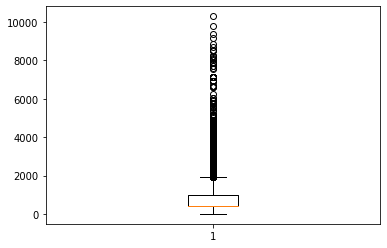

In [347]:
#Checking whether this filtering has left any outliers that are clearly not buying a personal insurance plan
plt.boxplot(fema_insurance_to_analyze[['totalInsurancePremiumOfThePolicy']])

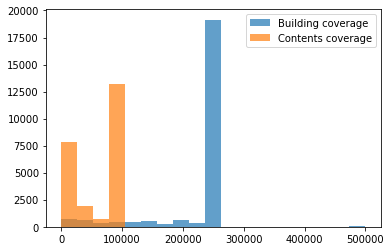

In [348]:
#How does building coverage compare to contents coverage?
max_val = fema_insurance_to_analyze[['totalBuildingInsuranceCoverage', 'totalContentsInsuranceCoverage']].max().max()
bins = np.linspace(0, max_val, 20)
plt.hist(fema_insurance_to_analyze[['totalBuildingInsuranceCoverage']], bins = bins, alpha=0.7, label='Building coverage')
plt.hist(fema_insurance_to_analyze[['totalContentsInsuranceCoverage']], bins = bins, alpha=0.7, label='Contents coverage')
plt.legend(loc='upper right')
plt.show()

In [349]:
fema_insurance_to_analyze.groupby(['floodZone']).agg({'id':'nunique', 
                                                      'totalInsurancePremiumOfThePolicy':['mean', 'median', 'max', 'min'], 
                                                      'totalBuildingInsuranceCoverage':['mean'], 
                                                      'totalContentsInsuranceCoverage':['mean']
                                    })

id totalInsurancePremiumOfThePolicy                       \
          nunique                             mean  median    max   min   
floodZone                                                                 
A              64                      2276.421875  2366.5   4379     0   
A04            41                       822.756098   727.0   1448   309   
A05            49                       740.102041   605.0   2703   258   
A06            24                       668.083333   487.0   2928    63   
A07             6                       957.000000   501.0   3391   365   
A08             3                      3090.000000  3148.0   3444  2678   
A09             6                      1176.000000   780.0   2261   489   
A10            12                      1506.583333   745.0   4022   104   
AE           9291                      1535.471532  1143.0  10294     0   
AO              7                      1351.285714  1411.0   1660  1109   
B             379                      1496.857520  1491.0   2621     0   
C             124                      1353.346774  1330.0   3626     0   
V12             2                      2596.500000  2596.5   3821  1372   
VE             99                      4342.888889  4515.0   9774   327   
X           13512                       424.493561   419.0   3644     0   

          totalBuildingInsuranceCoverage totalContentsInsuranceCoverage  
                                    mean                           mean  
floodZone                                                                
A                          208026.562500                   11479.687500  
A04                        242936.585366                   32058.536585  
A05                        219579.591837                   38522.448980  
A06                        233579.166667                   25641.666667  
A07                        241166.666667                   48316.666667  
A08                        250000.000000                   13400.000000  
A09                        245733.333333                   42516.666667  
A10                        229991.666667                   39033.333333  
AE                         221776.816274                   23947.652885  
AO                         240214.285714                    8714.285714  
B                          227268.601583                   37761.741425  
C                          231530.645161                   42011.290323  
V12                        160000.000000                       0.000000  
VE                         208832.323232                    8384.848485  
X                          226838.262285                   90815.941385

In [350]:
#What does it mean to have a zero dollar insurance premium? Drop these? 
print("There are {} records of policies that have a $0 insurance premium. Dropping these.".format(fema_insurance_to_analyze[fema_insurance_to_analyze['totalInsurancePremiumOfThePolicy'] == 0].shape[0]))
fema_insurance_to_analyze = fema_insurance_to_analyze[fema_insurance_to_analyze['totalInsurancePremiumOfThePolicy'] != 0]

There are 40 records of policies that have a $0 insurance premium. Dropping these.


### Guide to zone labels in this dataset
https://www.fema.gov/openfema-data-page/openfema-dataset-fima-nfip-redacted-policies--v1
- A - Special Flood with no Base Flood Elevation on FIRM
- AE, A1-A30 - Special Flood with Base Flood Elevation on FIRM
- A99 - Special Flood with Protection Zone
- AH, AHB* - Special Flood with Shallow Ponding
- AO, AOB* - Special Flood with Sheet Flow
- X, B - Moderate Flood from primary water source. Pockets of areas subject to drainage problems
- X, C - Minimal Flood from primary water source. Pockets of areas subject to drainage problems
- D - Possible Flood
- V - Velocity Flood with no Base Flood Elevation on FIRM
- VE, V1-V30 - Velocity Flood with Base Flood Elevation on FIRM
- AE, VE, X - New zone designations used on new maps starting January 1, 1986, in lieu of A1-A30, V1-V30, and B and C - AR - A Special Flood Hazard Area that results from the decertification of a previously accredited flood protection  system that is determined to be in the process of being restored to provide base flood protection
- AR Dual Zones - (AR/AE, AR/A1-A30, AR/AH, AR/AO, AR/A) Areas subject to flooding from failure of the flood protection system (Zone AR) which also overlap an existing Special Flood Hazard Area as a dual zone
- *AHB, AOB, ARE, ARH, ARO, and ARA are not risk zones shown on a map, but are acceptable values for rating purposes

In [351]:
#Extract everything that is low risk - all other codes are high risk
low_to_mid_risk = ['X', 'B', 'C']
fema_insurance_to_analyze['flood_risk_cat'] = np.nan
fema_insurance_to_analyze.loc[fema_insurance_to_analyze['floodZone'].isin(low_to_mid_risk), 'flood_risk_cat'] = 'low_to_mid'
fema_insurance_to_analyze.loc[~fema_insurance_to_analyze['floodZone'].isin(low_to_mid_risk), 'flood_risk_cat'] = 'high'

In [352]:
fema_insurance_to_analyze.groupby(['flood_risk_cat']).agg({'id':'nunique', 
                                                      'totalInsurancePremiumOfThePolicy':['mean', 'median', 'max', 'min'], 
                                                      'totalBuildingInsuranceCoverage':['mean'], 
                                                      'totalContentsInsuranceCoverage':['mean']
                                    })

id totalInsurancePremiumOfThePolicy                    \
               nunique                             mean median    max min   
flood_risk_cat                                                              
high              9583                      1563.449233   1143  10294  29   
low_to_mid       13996                       462.337882    421   3644  22   

               totalBuildingInsuranceCoverage totalContentsInsuranceCoverage  
                                         mean                           mean  
flood_risk_cat                                                                
high                            221697.464260                   23852.588727  
low_to_mid                      226874.335524                   88958.709631

In [353]:
#Do premiums vary by whether they get content insurance on top of property insurance (within flood zones)? - not dramatically
fema_insurance_to_analyze['content_and_building_coverage'] = (fema_insurance_to_analyze['totalBuildingInsuranceCoverage']>0) & (fema_insurance_to_analyze['totalContentsInsuranceCoverage']>0)
fema_insurance_to_analyze.groupby(['flood_risk_cat', 'content_and_building_coverage']).agg({'id':'nunique', 
                                                      'totalInsurancePremiumOfThePolicy':['mean', 'median', 'max', 'min'], 
                                    })

id  \
                                             nunique   
flood_risk_cat content_and_building_coverage           
high           False                            4922   
               True                             4661   
low_to_mid     False                             714   
               True                            13282   

                                             totalInsurancePremiumOfThePolicy  \
                                                                         mean   
flood_risk_cat content_and_building_coverage                                    
high           False                                              1609.221048   
               True                                               1515.114353   
low_to_mid     False                                               638.677871   
               True                                                452.858380   

                                                                
                                             median    max min  
flood_risk_cat content_and_building_coverage                    
high           False                           1380  10294  39  
               True                             891   9375  29  
low_to_mid     False                            239   3644  22  
               True                             421   2752  28

In [354]:
#Turn latitute and longitude into a point geometry
fema_insurance_gdf = gpd.GeoDataFrame(
    fema_insurance_to_analyze, geometry=gpd.points_from_xy(fema_insurance_to_analyze.longitude, fema_insurance_to_analyze.latitude))

In [356]:
#Latitudes and longitudes are unhelpful because they've been grouped coarsely to protect identity
Map(Layer(
    fema_insurance_gdf, 
    size_continuous_style('totalInsurancePremiumOfThePolicy', size_range=[10,40]), 
    title='Insurance premiums of plans effective in 2019'))


#### Import zoning data from MapPluto
MapPluto data dictionary - https://www1.nyc.gov/assets/planning/download/pdf/data-maps/open-data/pluto_datadictionary.pdf?v=20v6


In [104]:
print(fiona.listlayers('raw_data/MapPluto/MapPLUTO_20v6.gdb'))

mappluto = gpd.read_file("raw_data/MapPluto/MapPLUTO_20v6.gdb", driver='FileGDB', layer='MapPLUTO_20v6_clipped')

#Project
mappluto = to_epsg_4326(mappluto)
print("There are {} tax lots in MapPluto".format(mappluto.shape[0]))
display(mappluto.head())

#Merge in the description of each land use numeric id
land_use_descriptions = ['One & Two Family Buildings', 'Multi-Family Walk-Up Buildings', 'Multi-Family Elevator Buildings', 'Mixed Residential & Commercial Buildings', 'Commercial & Office Buildings', 'Industrial & Manufacturing', 'Transportation & Utility', 'Public Facilities & Institutions', 'Open Space & Outdoor Recreation', 'Parking Facilities', 'Vacant Land']
land_use_ids = list(range(1,len(land_use_descriptions)+1))
land_use_ids = ['0' + str(val) if len(str(val))==1 else str(val) for val in land_use_ids]
land_use_dict = pd.DataFrame({'land_use_id':land_use_ids, 'land_use_description':land_use_descriptions})
display(land_use_dict)

#Merge in landuse descriptions
mappluto = mappluto.merge(land_use_dict, left_on = 'LandUse', right_on = 'land_use_id', how = 'left')
display(mappluto[['LandUse', 'land_use_description']].head())

#Replace lots missing land use categorization with 'Not defined'
taxlots_in_high_risk_EFIRM.loc[taxlots_in_high_risk_EFIRM['LandUse'].isna(), 'land_use_description'] = "Not defined"

['MapPLUTO_20v6_clipped', 'NOT_MAPPED_LOTS']
Current CRS was epsg:2263. Reprojecting to epsg:4326.
There are 857195 tax lots in MapPluto


,Borough,Block,Lot,CD,CT2010,CB2010,SchoolDist,Council,ZipCode,FireComp,...,FIRM07_FLAG,PFIRM15_FLAG,Version,DCPEdited,Latitude,Longitude,Notes,Shape_Leng,Shape_Area,geometry
0,MN,1,10,101.0,5,1000,02,1.0,10004.0,E007,...,1,1,20v6,None,40.688799,-74.018675,None,0.0,7.550339e+06,"MULTIPOLYGON (((-74.02240 40.68442, -74.02404 ..."
1,MN,1,101,101.0,1,1001,02,1.0,10004.0,E007,...,None,1,20v6,None,40.689920,-74.045337,None,0.0,5.018973e+05,"MULTIPOLYGON (((-74.04270 40.69006, -74.04263 ..."
2,MN,1,201,101.0,1,1000,02,NaN,10004.0,None,...,None,1,20v6,None,40.698188,-74.041329,None,0.0,1.148539e+06,"MULTIPOLYGON (((-74.03823 40.69837, -74.03823 ..."
3,MN,2,1,101.0,9,1025,02,1.0,10004.0,L015,...,1,1,20v6,t,40.700369,-74.012911,None,0.0,1.008250e+05,"MULTIPOLYGON (((-74.01302 40.69976, -74.01313 ..."
4,MN,2,2,101.0,9,1025,02,1.0,10004.0,L015,...,1,1,20v6,None,40.700550,-74.011588,None,0.0,8.724425e+04,"MULTIPOLYGON (((-74.01203 40.70004, -74.01246 ..."


#### Extract the tax lots that fall within high risk flood zones in the 2007 effective FIRM and 2015 preliminary FIRM
Set to return all tax lots that have any portion (even if not all) inside a high risk zone

In [107]:
taxlots_in_high_risk_EFIRM = gpd.sjoin(mappluto, high_risk_gdf_EFIRM, how="inner", op='intersects')

In [115]:
#Extract landuse cats to order them (ie. assign them the same color) in each map
landuse_cats = list(taxlots_in_high_risk_EFIRM['land_use_description'].unique())
#Remove nonetype cat
landuse_cats = [cat for cat in landuse_cats if cat]
# landuse_cats.sort()
print(landuse_cats)

['Public Facilities & Institutions', 'Transportation & Utility', 'Open Space & Outdoor Recreation', 'Commercial & Office Buildings', 'Not defined', 'Mixed Residential & Commercial Buildings', 'Industrial & Manufacturing', 'Parking Facilities', 'Multi-Family Elevator Buildings', 'Vacant Land', 'Multi-Family Walk-Up Buildings', 'One & Two Family Buildings']


In [117]:
# Map([Layer(taxlots_in_high_risk_EFIRM, 
# style=color_category_style('land_use_description', cat=landuse_cats), 
# legends=basic_legend(title='Land use'), 
# encode_data =False)])

In [ ]:
taxlots_in_high_risk_PFIRM = gpd.sjoin(mappluto, high_risk_gdf_PFIRM, how="inner", op='intersects')

In [ ]:
# Map([Layer(taxlots_in_high_risk_PFIRM, 
#            style=color_category_style('land_use_description', cat=landuse_cats), 
#            legends=basic_legend(title='Land use'), 
#            encode_data =False)])

### Extract residential

In [ ]:
#In story map go from all zones to just residential (keep colors constant)

#### Import American Community Survey data
Variables of interest in this survey:
- Percent of each census tract that has a mortgage (unfortunately doesn't distinguish between federally-backed and non-federally backed but gives an upper bound on the percent of people who would be required to buy FEMA insurance if they are also in a flood zone)


Using censusdata python package which is up to date for the 1-year estimates. It had been missing the 2019 ACS1 data, but I a opened github issue and it has successfully been added in version 1.10. The 2019 one-year data was released by census on September 17, 2020 and is the most recent available data. Unfortunately, ACS1 only goes down to the county level (and only for areas where population is 65,000 or more), so to get block level data we need to use ACS 5 year estimates. The most recent ACS5 data will be released December 10, 2020 so for right now we need to use the 2014-2018 ones. (Release schedule - https://www.census.gov/programs-surveys/acs/news/data-releases/2019/release-schedule.html)

Package usage: https://towardsdatascience.com/accessing-census-data-with-python-3e2f2b56e20d

Could always use the ACS API directly but seems like this takes a lot of work (hence the above censusdata package exists)  - https://www.census.gov/data/developers/data-sets/acs-1year.html

In [67]:
#Find the variable code for the mortgage question I want to extract
sample = censusdata.search('acs5', 2018,'concept', 'mortgage')
print(len(sample))
print(sample)

237
[('B25027_001E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:'), ('B25027_002E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:'), ('B25027_003E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Householder 15 to 34 years'), ('B25027_004E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Householder 35 to 44 years'), ('B25027_005E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Householder 45 to 54 years'), ('B25027_006E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Householder 55 to 59 years'), ('B25027_007E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Householder 60 to 64 years'), ('B25027_008E', 'MORTGAGE STATUS BY AGE OF HOUSEHOLDER', 'Estimate!!Total:!!Housing units with a mortgage:!!Household

In [359]:
#Find the variable code for the income data I want to extract
sample = censusdata.search('acs5', 2018,'concept', 'income')
print(len(sample))
print(sample)

3133
[('B05010_001E', 'RATIO OF INCOME TO POVERTY LEVEL IN THE PAST 12 MONTHS BY NATIVITY OF CHILDREN UNDER 18 YEARS IN FAMILIES AND SUBFAMILIES BY LIVING ARRANGEMENTS AND NATIVITY OF PARENTS', 'Estimate!!Total'), ('B05010_002E', 'RATIO OF INCOME TO POVERTY LEVEL IN THE PAST 12 MONTHS BY NATIVITY OF CHILDREN UNDER 18 YEARS IN FAMILIES AND SUBFAMILIES BY LIVING ARRANGEMENTS AND NATIVITY OF PARENTS', 'Estimate!!Total!!Under 1.00'), ('B05010_003E', 'RATIO OF INCOME TO POVERTY LEVEL IN THE PAST 12 MONTHS BY NATIVITY OF CHILDREN UNDER 18 YEARS IN FAMILIES AND SUBFAMILIES BY LIVING ARRANGEMENTS AND NATIVITY OF PARENTS', 'Estimate!!Total!!Under 1.00!!Living with two parents'), ('B05010_004E', 'RATIO OF INCOME TO POVERTY LEVEL IN THE PAST 12 MONTHS BY NATIVITY OF CHILDREN UNDER 18 YEARS IN FAMILIES AND SUBFAMILIES BY LIVING ARRANGEMENTS AND NATIVITY OF PARENTS', 'Estimate!!Total!!Under 1.00!!Living with two parents!!Both parents native'), ('B05010_005E', 'RATIO OF INCOME TO POVERTY LEVEL IN TH

#### Variables to extract:
- Counts of number of surveyed households who have mortgages v. don't is stored in variable 'B25081' (Percent of households with mortgage = B25081_002E/B25081_001E)
- Counts of income bracket is stored in variable '

Note: some of the subvariables of B25081 are subsets of each other and is captured in the dataset when they are nested - https://data.census.gov/cedsci/table?q=B25081&g=0400000US53&tid=ACSDT1Y2018.B25081&hidePreview=true
(This is true for many of the variables. The total is stored in one of the subvariables usually. This can be used to calculate percentages instead of counts.)

In [68]:
censusdata.censustable('acs5', 2018, 'B25081')

OrderedDict([('B25081_001E',
              {'label': 'Estimate!!Total',
               'concept': 'MORTGAGE STATUS',
               'predicateType': 'int'}),
             ('B25081_002E',
              {'label': 'Estimate!!Total!!Housing units with a mortgage, contract to purchase, or similar debt',
               'concept': 'MORTGAGE STATUS',
               'predicateType': 'int'}),
             ('B25081_003E',
              {'label': 'Estimate!!Total!!Housing units with a mortgage, contract to purchase, or similar debt!!With either a second mortgage or home equity loan, but not both',
               'concept': 'MORTGAGE STATUS',
               'predicateType': 'int'}),
             ('B25081_004E',
              {'label': 'Estimate!!Total!!Housing units with a mortgage, contract to purchase, or similar debt!!With either a second mortgage or home equity loan, but not both!!Second mortgage only',
               'concept': 'MORTGAGE STATUS',
               'predicateType': 'int'}),
      

In [69]:
#Get codes for New York state and counties which we're interested in
states = censusdata.geographies(censusdata.censusgeo([('state', '*')]), 'acs5', 2018)
print(states['New York'])

Summary level: 040, state:36


In [70]:
#Need to extract counties in New York City (New York County (Manhattan), Kings County (Brooklyn), Bronx County (The Bronx), Richmond County (Staten Island), and Queens County (Queens))
counties = censusdata.geographies(censusdata.censusgeo([('state', '36'), ('county', '*')]), 'acs5', 2018)
print(counties)

{'Schoharie County, New York': censusgeo((('state', '36'), ('county', '095'))), 'Onondaga County, New York': censusgeo((('state', '36'), ('county', '067'))), 'Clinton County, New York': censusgeo((('state', '36'), ('county', '019'))), 'Seneca County, New York': censusgeo((('state', '36'), ('county', '099'))), 'Putnam County, New York': censusgeo((('state', '36'), ('county', '079'))), 'Franklin County, New York': censusgeo((('state', '36'), ('county', '033'))), 'Ontario County, New York': censusgeo((('state', '36'), ('county', '069'))), 'Queens County, New York': censusgeo((('state', '36'), ('county', '081'))), 'Steuben County, New York': censusgeo((('state', '36'), ('county', '101'))), 'Hamilton County, New York': censusgeo((('state', '36'), ('county', '041'))), 'Washington County, New York': censusgeo((('state', '36'), ('county', '115'))), 'Chautauqua County, New York': censusgeo((('state', '36'), ('county', '013'))), 'Kings County, New York': censusgeo((('state', '36'), ('county', '0

In [12]:
'''
Keep codes same as in MapPluto
BX Bronx
BK Brooklyn
MN Manhattan
QN Queens
SI Staten Island
'''

#Extract the county codes for the places you want to extract data for
counties = {'BX':'005', 'MN':'061', 'BK':'047', 'QN':'081', 'SI':'085'}
ACS_data_by_county = {}
for county_name, county_code in counties.items():
    data = censusdata.download('acs5', 2018,
               censusdata.censusgeo([('state', '36'),
                                     ('county', county_code),
                                    ('block group', '*')]),
              ['B25081_002E','B25081_001E'])
    print('There are {} census blocks in {} county'.format(data.shape[0], county_name))
    
    #Download returns a dataframe where index stores the geography info
    data.reset_index(inplace = True)
    data.rename(columns= {'index':'geocensus_object'}, inplace = True)
    
    #Index is a censusgeo object whose components can be accessed through .geo and .name
    example_row = data.iloc[0]
    geographies = [geo_code_tuple[0] for geo_code_tuple in example_row['geocensus_object'].geo]

    for i in range(len(geographies)):
        geography = geographies[i]
        data[geography] = data.apply(lambda row: row['geocensus_object'].geo[i][1], axis = 1)
        data['geography_name_str'] = data.apply(lambda row: row['geocensus_object'].name, axis = 1)
    
    #Drop the geocensus object
    data.drop(columns = 'geocensus_object', inplace = True)
    
    #Add in borough code
    data['county_code'] = county_name
    
    #Add cleaned data to dictionary to concatenate later
    ACS_data_by_county[county_name] = data
    
ACS_df = pd.concat(list(ACS_data_by_county.values()), ignore_index = True, axis = 0, sort = False)
display(ACS_df.head())

There are 1154 census blocks in BX county
There are 1170 census blocks in MN county
There are 2085 census blocks in BK county
There are 1746 census blocks in QN county
There are 338 census blocks in SI county


,B25081_002E,B25081_001E,state,geography_name_str,county,tract,block group,county_code
0,20,20,36,"Block Group 3, Census Tract 245.02, Bronx Coun...",005,024502,3,BX
1,0,15,36,"Block Group 2, Census Tract 247, Bronx County,...",005,024700,2,BX
2,8,17,36,"Block Group 4, Census Tract 253, Bronx County,...",005,025300,4,BX
3,31,31,36,"Block Group 5, Census Tract 263, Bronx County,...",005,026300,5,BX
4,15,15,36,"Block Group 4, Census Tract 265, Bronx County,...",005,026500,4,BX


In [13]:
#Calculate the percent of people surveyed that have a mortgage
ACS_df.rename(columns = {'B25081_002E':'num_households_mortgage', 'B25081_001E':'total_households_surveyed'}, inplace=True)
ACS_df['percent_with_mortgage'] = ACS_df['num_households_mortgage']/ACS_df['total_households_surveyed']*100

#Fix column names from geography tuples
ACS_df.rename(columns = {'block group':'block_group'}, inplace = True)
ACS_df.head()

,num_households_mortgage,total_households_surveyed,state,geography_name_str,county,tract,block_group,county_code,percent_with_mortgage
0,20,20,36,"Block Group 3, Census Tract 245.02, Bronx Coun...",005,024502,3,BX,100.000000
1,0,15,36,"Block Group 2, Census Tract 247, Bronx County,...",005,024700,2,BX,0.000000
2,8,17,36,"Block Group 4, Census Tract 253, Bronx County,...",005,025300,4,BX,47.058824
3,31,31,36,"Block Group 5, Census Tract 263, Bronx County,...",005,026300,5,BX,100.000000
4,15,15,36,"Block Group 4, Census Tract 265, Bronx County,...",005,026500,4,BX,100.000000


In [9]:
#Load census tract shapefiles - https://www.census.gov/cgi-bin/geo/shapefiles/index.php?year=2018&layergroup=Census+Tracts
census_tract_gdf = gpd.read_file('raw_data/new_york_census_tract_shapefiles/tl_2018_36_tract.shp')

census_tract_gdf = to_epsg_4326(census_tract_gdf)

display(census_tract_gdf.head())


Current CRS was epsg:4269. Reprojecting to epsg:4326.


,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,36,007,012702,36007012702,127.02,Census Tract 127.02,G5020,S,65411230,228281,+42.0350532,-075.9055509,"POLYGON ((-75.95917 42.00852, -75.95914 42.008..."
1,36,007,012800,36007012800,128,Census Tract 128,G5020,S,12342855,259439,+42.1305335,-075.9181575,"POLYGON ((-75.94766 42.13727, -75.94453 42.137..."
2,36,007,012900,36007012900,129,Census Tract 129,G5020,S,14480253,63649,+42.1522758,-075.9766029,"POLYGON ((-76.02229 42.15699, -76.01917 42.157..."
3,36,007,013000,36007013000,130,Census Tract 130,G5020,S,9934434,381729,+42.1236499,-076.0002197,"POLYGON ((-76.02417 42.12590, -76.02409 42.125..."
4,36,007,013202,36007013202,132.02,Census Tract 132.02,G5020,S,2451349,3681,+42.1238924,-076.0311921,"POLYGON ((-76.03996 42.13284, -76.03862 42.132..."


In [33]:
#Format ACS census tract id to be a string that matches census tract ID
ACS_df['tract_name_formatted'] = ACS_df.apply(lambda row: str(int(row['tract'][:4])) + '.' + row['tract'][4:] if int(row['tract'][4:]) !=0 else  str(int(row['tract'][:4])), axis = 1)


#### Merge in the shapefiles for census tracts

In [39]:
#Merge census tracts shapefiles with ACS data
ACS_gdf = census_tract_gdf[['NAME', 'geometry']].merge(ACS_df, left_on = 'NAME', right_on = 'tract_name_formatted', how = 'right')

#Check that the merge works for all
no_geometry = ACS_gdf[ACS_gdf['NAME'].isna()]
print("There are {} census tracts where there was no tract geometry found with that name".format(no_geometry.shape[0]))


There are 0 census tracts where there was no tract geometry found with that name


In [49]:
#Extract the census tracts that fall within the high risk FIRMs (preliminary and effective)
ACS_in_high_risk_EFIRM = gpd.sjoin(ACS_gdf, high_risk_gdf_EFIRM, how="inner", op='intersects')
ACS_in_high_risk_PFIRM = gpd.sjoin(ACS_gdf, high_risk_gdf_PFIRM, how="inner", op='intersects')

In [58]:
#Separate those that have survey data available and those that do not
ACS_in_high_risk_EFIRM_unsurveyed = ACS_in_high_risk_EFIRM[ACS_in_high_risk_EFIRM['total_households_surveyed'] == 0]
ACS_in_high_risk_EFIRM_surveyed = ACS_in_high_risk_EFIRM[ACS_in_high_risk_EFIRM['total_households_surveyed'] != 0]


In [357]:
#Take out encode_date=False to have legend in separate tab
surveyed_layer = Layer(
    ACS_in_high_risk_EFIRM_surveyed, 
    style=color_continuous_style('percent_with_mortgage', palette = 'Brwnyl'), 
    legends=basic_legend(title='Percent households with mortgages'),
    encode_data =False)

unsurveyed_layer = Layer(ACS_in_high_risk_EFIRM_unsurveyed, 
       style=basic_style(color='lightgray', opacity=.02), 
       legends=basic_legend(title='Unsurveyed tract'), 
       encode_data=False)

#The layer listed last appears as the top layer on the map
Map(layers = [unsurveyed_layer, surveyed_layer])

In [ ]:
#Are the unmapped census tracts in the harbor area of Brooklyn non-residential zones?

#### Calculate the median income for each census tract
- Then calculate which flood zone the majority of the tract falls in (will need to think about what to do with the ones that are 50/50) and use the insurance premium data I analyzed earlier in the data to calculate the percent of median income that the average premium of that flood zone would require families to spend

#### Spatial join of census tracts with MapPluto zones

Might be useful for continuity of the narrative visualization

Decide what to do with census tracts that are partly in one zone and partly in the other? 
- MapPluto lists the census tract ID that each zone falls in

#### Import data from FEMA on who has historically received help (independent of insurance) after flooding
https://www.fema.gov/about/openfema/data-sets#individual